In [1]:
import sys
import os

sys.path.insert(0, os.path.abspath("."))
sys.path.append(os.path.abspath("../../../"))

In [2]:
from desc import set_device
set_device("gpu")

In [3]:
import numpy as np
np.set_printoptions(linewidth=np.inf, precision=4, suppress=True, threshold=sys.maxsize)
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go
import functools
import scipy

In [4]:
import desc

from desc.basis import *
from desc.backend import *
from desc.compute import *
from desc.coils import *
from desc.equilibrium import *
from desc.examples import *
from desc.grid import *
from desc.geometry import *

from desc.objectives import *
from desc.objectives.objective_funs import *
from desc.objectives.getters import *
from desc.objectives.normalization import compute_scaling_factors
from desc.objectives.utils import *
from desc.optimize._constraint_wrappers import *

from desc.transform import Transform
from desc.plotting import *
from desc.optimize import *
from desc.perturbations import *
from desc.profiles import *
from desc.compat import *
from desc.utils import *
from desc.magnetic_fields import *

from desc.__main__ import main
from desc.vmec_utils import vmec_boundary_subspace
from desc.input_reader import InputReader
from desc.continuation import solve_continuation_automatic

print_backend_info()

DESC version=0.14.1+371.g6a626f49a.
Using JAX backend: jax version=0.5.0, jaxlib version=0.5.0, dtype=float64.
Using device: NVIDIA GeForce RTX 4080 Laptop GPU (id=0), with 10.88 GB available memory.


In [5]:
def plot_field_lines(field, equ, ntransit=200, nrho=9):
    # for starting locations we'll pick positions on flux surfaces on the outboard midplane
    grid_trace = LinearGrid(rho=np.linspace(0, 1, nrho))
    r0 = equ.compute("R", grid=grid_trace)["R"]
    z0 = equ.compute("Z", grid=grid_trace)["Z"]
    fig, ax = desc.plotting.plot_surfaces(equ)
    fig, ax = desc.plotting.poincare_plot(
        field,
        r0,
        z0,
        NFP=equ.NFP,
        ax=ax,
        color="k",
        size=0.5,
        ntransit=ntransit,
    )
    return fig, ax

def plot_init_coils_modular(equ, ncoils=3, r_over_a=3.5):
    coilset = initialize_modular_coils(
        equ, num_coils=ncoils, r_over_a=r_over_a
    ).to_FourierXYZ()
    fig = plot_3d(equ, "|B|")
    fig = plot_coils(coilset, fig=fig)
    return fig

In [6]:
def optimize_coils(equ, coilset0=None):
    if coilset0 is None:
        coilset0 = initialize_modular_coils(
            equ, num_coils=3, r_over_a=3.5
        ).to_FourierXYZ()
    # define our objective function (we will use a helper function here to make it easier to change weights later)
    weights = {
        "quadratic flux": 500,
        "coil-coil min dist": 100,
        "plasma-coil min dist": 10,
        "coil curvature": 250,
        "coil length": 20,
    }
    coil_grid = LinearGrid(N=50)
    # similarly define a grid on the plasma surface where B*n errors will be evaluated
    plasma_grid = LinearGrid(M=25, N=25, NFP=equ.NFP, sym=equ.sym)
    obj = ObjectiveFunction(
        (
            QuadraticFlux(
                equ,
                field=coilset0,
                # grid of points on plasma surface to evaluate normal field error
                eval_grid=plasma_grid,
                field_grid=coil_grid,
                vacuum=True,  # vacuum=True means we won't calculate the plasma contribution to B as it is zero
                weight=weights["quadratic flux"],
                bs_chunk_size=10,
            ),
            CoilCurvature(
                coilset0,
                bounds=(-1, 2),
                normalize_target=False,  # we're giving bounds in normalized units
                grid=coil_grid,
                weight=weights["coil curvature"],
            ),
            CoilLength(
                coilset0,
                bounds=(0, 2 * np.pi * (coilset0[0].compute("length")["length"])),
                normalize_target=True,  # target length is in meters, not normalized
                grid=coil_grid,
                weight=weights["coil length"],
            ),
        )
    )
    coil_indices_to_fix_current = [False for c in coilset0]
    coil_indices_to_fix_current[0] = True
    constraints = (FixCoilCurrent(coilset0, indices=coil_indices_to_fix_current),)

    optimizer = Optimizer("lsq-exact")

    (optimized_coilset,), _ = optimizer.optimize(
        coilset0,
        objective=obj,
        constraints=constraints,
        maxiter=200,
        verbose=3,
        ftol=1e-6,
        xtol=0,
        copy=True,
    )
    return optimized_coilset

In [7]:
def optimize_coils_regcoil(surf, equ, num_coils=16):
    # create the FourierCurrentPotentialField object from the constant offset surface we found in the previous cell
    surface_current_field = FourierCurrentPotentialField.from_surface(
        surf,
        I=0,
        # manually setting G to value needed to provide the equilibrium's toroidal flux,
        # though this is not necessary as it gets set automatically inside the solve_regularized_surface_current function
        G=np.asarray(
            [
                -equ.compute("G", grid=LinearGrid(rho=np.array(1.0)))["G"][0]
                / mu_0
                * 2
                * np.pi
            ]
        ),
        # set symmetry of the current potential, "sin" is usually expected for stellarator-symmetric surfaces and equilibria
        sym_Phi="sin",
    )

    surface_current_field.change_Phi_resolution(M=12, N=12)

    # create the evaluation grid (where Bn will be minimized on plasma surface)
    # and source grid (discretizes the source K for Biot-Savart and where |K| will be penalized on winding surface)
    Megrid = 20
    Negrid = 20
    Msgrid = 20
    Nsgrid = 20

    eval_grid = LinearGrid(M=Megrid, N=Negrid, NFP=eq.NFP, sym=False)
    # ensure that sym=False for source grid so the field evaluated from the surface current is accurate
    # (i.e. must evaluate source over whole surface, not just the symmetric part)
    # NFP>1 is ok, as we internally will rotate the source through the field periods to sample entire winding surface
    sgrid = LinearGrid(M=Msgrid, N=Nsgrid, NFP=eq.NFP, sym=False)

    lambda_regularization = np.append(np.array([0]), np.logspace(-30, 1, 20))

    # solve_regularized_surface_current method runs the REGCOIL algorithm
    fields, data = solve_regularized_surface_current(
        surface_current_field,  # the surface current field whose geometry and Phi resolution will be used
        eq=equ,  # the Equilibrium object to minimize Bn on the surface of
        source_grid=sgrid,  # source grid
        eval_grid=eval_grid,  # evaluation grid
        current_helicity=(
            1,
            0,
        ),  # pair of integers (M_coil, N_coil), determines topology of contours (almost like  QS helicity),
        #  M_coil is the number of times the coil transits poloidally before closing back on itself
        # and N_coil is the toroidal analog (if M_coil!=0 and N_coil=0, we have modular coils, if both M_coil
        # and N_coil are nonzero, we have helical coils)
        # we pass in an array to perform scan over the regularization parameter (which we call lambda_regularization)
        # to see tradeoff between Bn and current complexity
        lambda_regularization=lambda_regularization,
        # lambda_regularization can also be just a single number in which case no scan is performed
        vacuum=True,  # this is a vacuum equilibrium, so no need to calculate the Bn contribution from the plasma currents
        regularization_type="regcoil",
        chunk_size=40,
    )
    surface_current_field = fields[
        0
    ]  # fields is a list of FourierCurrentPotentialField objects

    coilset = surface_current_field.to_CoilSet(num_coils=num_coils, stell_sym=True)
    
    return coilset

# Equilibrium with Islands from Landreman 2021 Paper

Landreman et. al. 2021 paper uses SPEC during optimization to calculate island residue. They compare VMEC and SPEC outputs, and use it as a cost in addition to other metrics like QA.

Equilibrium at 0x7f0f159c99a0 (L=3, M=3, N=4, NFP=2, sym=True, spectral_indexing=ansi, vacuum=True, profile='current')


(<Figure size 384.108x384.108 with 1 Axes>,
 <Axes: xlabel='$\\rho$', ylabel='$ \\frac{2\\pi}{\\mu_0} I ~(A)$'>)

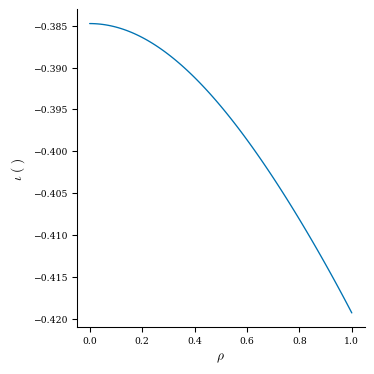

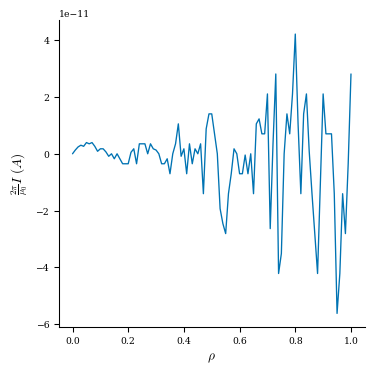

In [8]:
eq = desc.io.load("landreman2021-island-init.h5")
print(eq)
plot_1d(eq, "iota")
plot_1d(eq, "current")

In [48]:
# create the constant offset surface
surf = eq.surface.constant_offset_surface(
    offset=0.25,  # desired offset
    M=16,  # Poloidal resolution of desired offset surface
    N=16,  # Toroidal resolution of desired offset surface
    grid=LinearGrid(M=32, N=32, NFP=eq.NFP),
)  # grid of points on base surface to evaluate unit normal and find points on offset surface,
# generally should be twice the desired resolution
optimized_coilset = optimize_coils_regcoil(surf, eq, num_coils=16)

##########################################################
Calculating Phi_SV for lambda_regularization = 0.00000e+00
##########################################################
chi^2 B = 2.72990e-11
min Bnormal = 6.17719e-19 (T)
Max Bnormal = 3.46038e-08 (T)
Avg Bnormal = 6.75893e-09 (T)
min Bnormal = 6.31488e-19 (unitless)
Max Bnormal = 3.53751e-08 (unitless)
Avg Bnormal = 6.90959e-09 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 1.00000e-30
##########################################################
chi^2 B = 2.72990e-11
min Bnormal = 6.17719e-19 (T)
Max Bnormal = 3.46038e-08 (T)
Avg Bnormal = 6.75893e-09 (T)
min Bnormal = 6.31488e-19 (unitless)
Max Bnormal = 3.53751e-08 (unitless)
Avg Bnormal = 6.90959e-09 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 4.28133e-29
##########################################################
chi^2 B = 2.72990e-11
m

In [18]:
coil_grid = LinearGrid(N=50)
plasma_grid = LinearGrid(M=25, N=25, NFP=eq.NFP, sym=eq.sym)
plot_grid = LinearGrid(M=20, N=40, NFP=1, endpoint=True)

In [50]:
fig = plot_3d(
    eq.surface,
    "B*n",
    field=optimized_coilset,
    field_grid=coil_grid,
    grid=plot_grid,
)
fig = plot_coils(optimized_coilset, fig=fig)
fig.show()

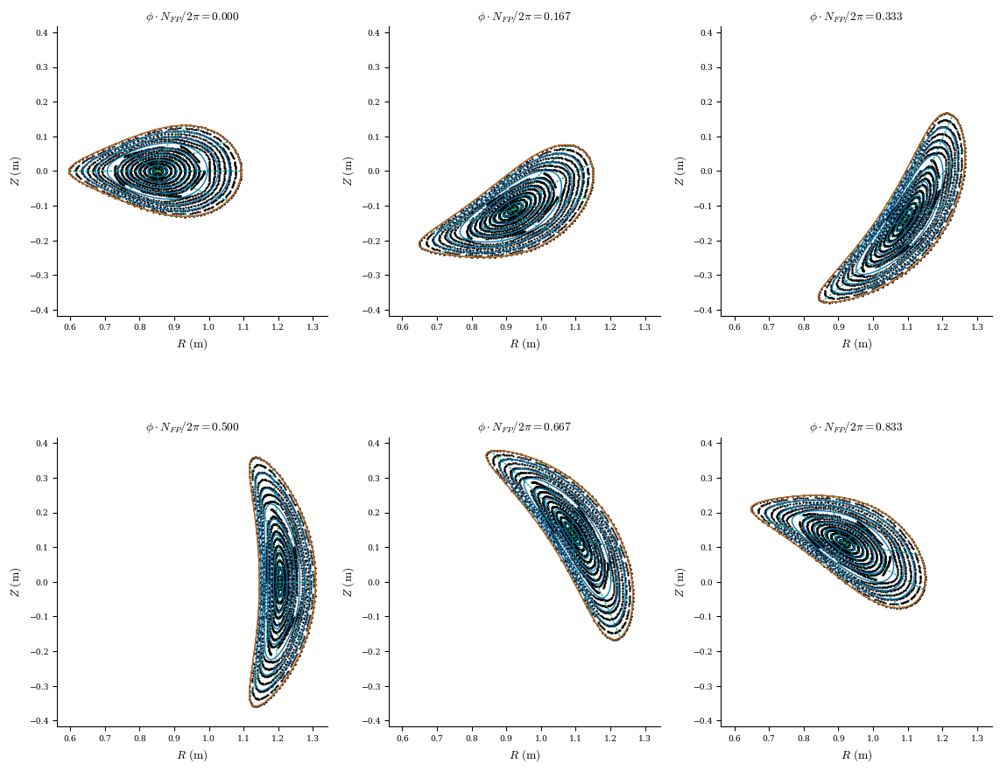

In [51]:
fig, ax = plot_field_lines(optimized_coilset, eq, ntransit=200, nrho=18)
plt.show()
fig.savefig("landreman2021-islands-before-poincare.png", dpi=1000)

Above figure show the island chain at $\iota=2/5$ surface. We will try to remove this island by using Poincare BC while still having rational $\iota$.

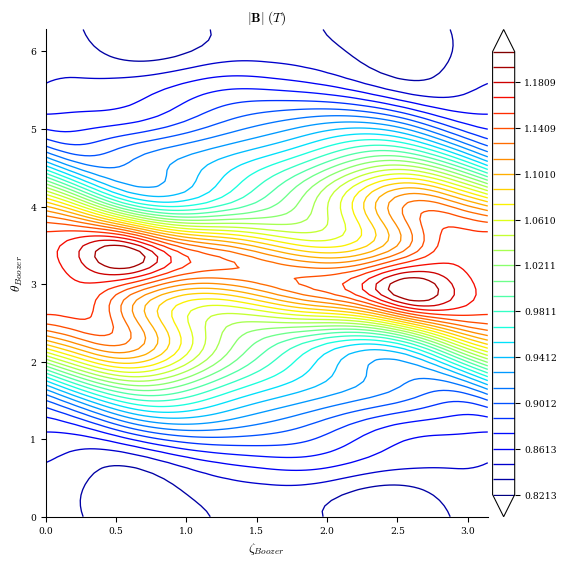

In [21]:
plot_boozer_surface(eq);

# Solve Equilibrium high Res

To get stable solution with Poincare, we need a really good initial equilibrium. For this, we will increase L and M resolution and solve fixed boundary equilibrium for low force error.

In [9]:
from desc.objectives.getters import *
from desc.objectives import *
def solve_poincare(eq2solve, fix_lambda=True, **kwargs):
    jac_chunk_size = kwargs.pop("jac_chunk_size", None)
    constraints = get_fixed_xsection_constraints(eq2solve, fix_lambda=fix_lambda)
    objective = ObjectiveFunction(ForceBalance(eq2solve, jac_chunk_size=jac_chunk_size))
    eq2solve.solve(constraints=constraints, objective=objective, verbose=3, **kwargs)

In [10]:
for res in [6, 8]:
    eq.change_resolution(L=res, M=res, L_grid=2*res, M_grid=2*res)
    eq.solve(verbose=3)
    eq.save(f"landreman2021-island-LM{res}N4.h5")

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 592 ms
Timer: Objective build = 1.06 sec
Building objective: fixed LCFS R
Building objective: fixed LCFS Z
Building objective: fixed Psi
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed sheet current
Building objective: self_consistency lcfs R
Building objective: self_consistency lcfs Z
Building objective: lambda gauge
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Timer: Objective build = 697 ms
Timer: LinearConstraintProjection build = 4.45 sec
Number of parameters: 259
Number of objectives: 1666
Timer: Initializing the optimization = 6.27 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          1.053e-01                                    3.671e-01   
       1              2          8.456e-04      1

In [11]:
for res in [6, 8]:
    eq.change_resolution(N=res, N_grid=2 * res)
    eq.solve(verbose=3)
    eq.save(f"landreman2021-island-LM8N{res}.h5")

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 59.2 ms
Timer: Objective build = 126 ms
Building objective: fixed LCFS R
Building objective: fixed LCFS Z
Building objective: fixed Psi
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed sheet current
Building objective: self_consistency lcfs R
Building objective: self_consistency lcfs Z
Building objective: lambda gauge
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Timer: Objective build = 533 ms
Timer: LinearConstraintProjection build = 4.50 sec
Number of parameters: 654
Number of objectives: 4050
Timer: Initializing the optimization = 5.30 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          9.051e-07                                    4.386e-04   
       1              3          2.870e-07      6.

(<Figure size 1152.32x960.27 with 6 Axes>,
 array([<Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.000$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>, <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.167$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>, <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.333$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>, <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.500$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>, <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.667$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>, <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.833$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>], dtype=object))

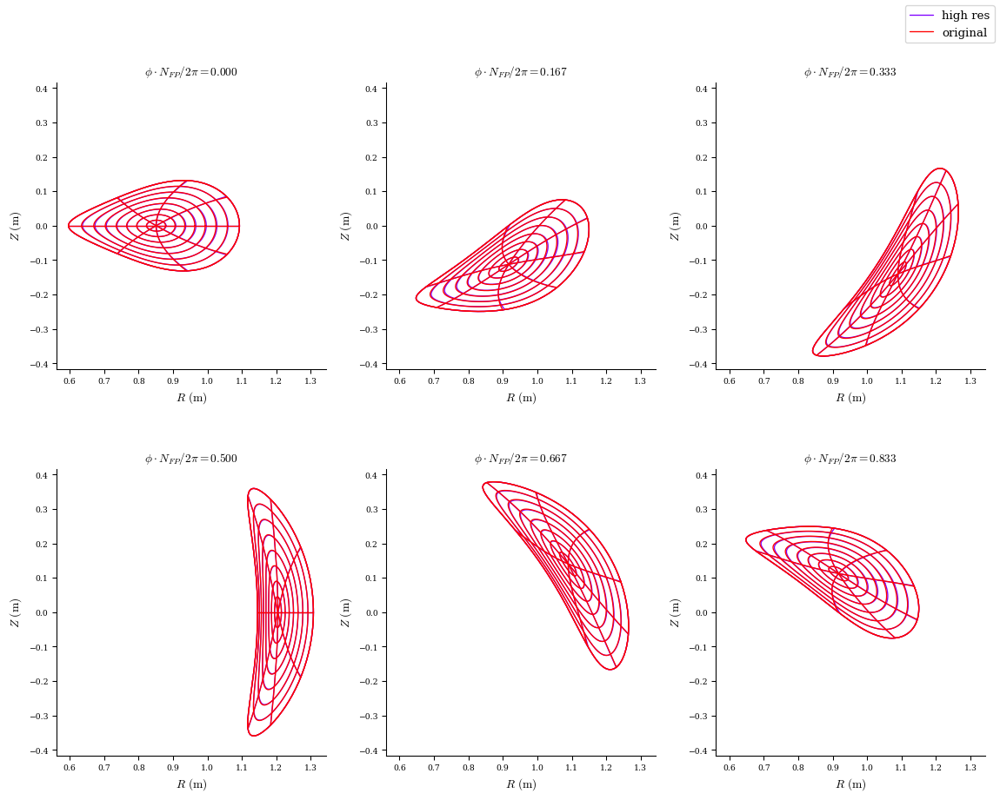

In [12]:
eq0 = desc.io.load("landreman2021-island-init.h5")
plot_comparison([eq, eq0], labels=["high res", "original"])

# Now solve with Poincare

We have a good equilibrium now. Let's fix the $\zeta=0$ cross-section and resolve using Poiincare BC.

In [34]:
eq._xsection = eq.get_surface_at(zeta=0)
eq_poin = eq.copy()
solve_poincare(eq_poin, maxiter=500, ftol=5e-4)
eq_poin.surface = eq_poin.get_surface_at(rho=1)

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 64.5 ms
Timer: Objective build = 87.1 ms
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed cross-section λ
Building objective: fixed Psi
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed sheet current
Building objective: lambda gauge
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Building objective: self_consistency section R
Building objective: self_consistency section Z
Building objective: self_consistency section λ
Timer: Objective build = 247 ms
Timer: LinearConstraintProjection build = 4.93 sec
Number of parameters: 1080
Number of objectives: 5346
Timer: Initializing the optimization = 5.38 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1   

In [35]:
eq_poin.save(f"landreman2021-island-poincare-solved-L{eq_poin.L}M{eq_poin.M}N{eq_poin.N}.h5")

As seen below, the boundary change is minimal. If we haven't solved for high res, this wouldn't be the case.

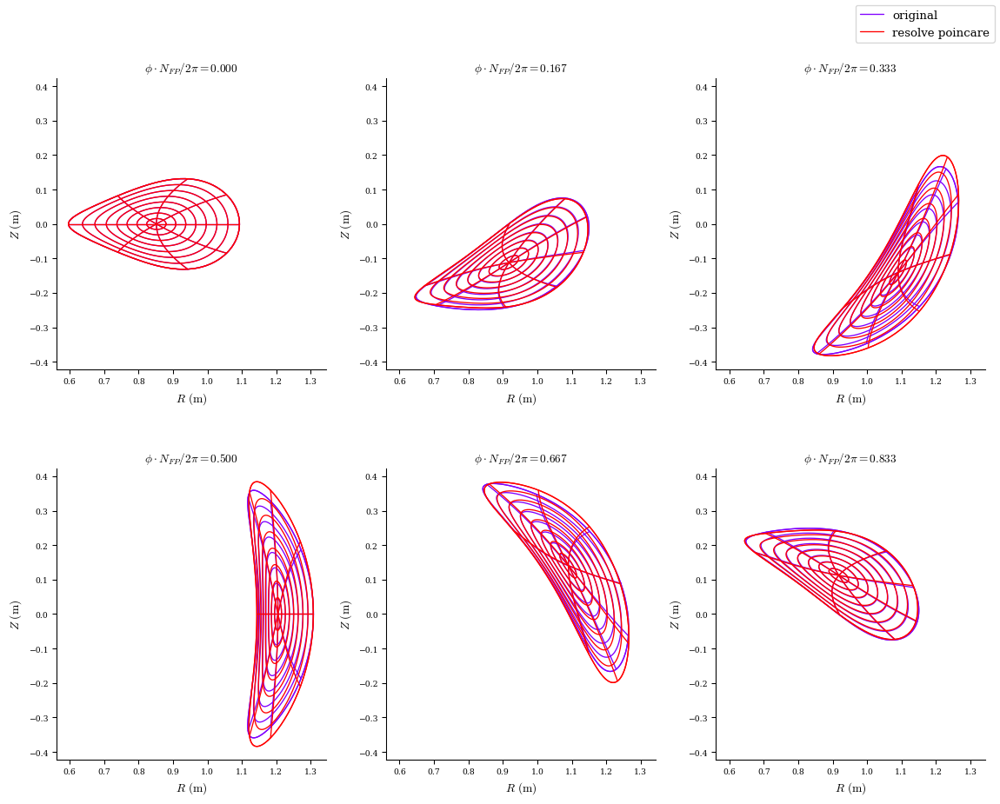

In [36]:
plot_comparison(eqs=[eq, eq_poin], labels=["original", "resolve poincare"]);

Optimize some coils for field line tracing.

In [37]:
# create the constant offset surface
surf2 = eq_poin.surface.constant_offset_surface(
    offset=0.25,  # desired offset
    M=16,  # Poloidal resolution of desired offset surface
    N=16,  # Toroidal resolution of desired offset surface
    grid=LinearGrid(M=32, N=32, NFP=eq_poin.NFP),
)  # grid of points on base surface to evaluate unit normal and find points on offset surface,
# generally should be twice the desired resolution
optimized_coilset2 = optimize_coils_regcoil(surf2, eq_poin)

##########################################################
Calculating Phi_SV for lambda_regularization = 0.00000e+00
##########################################################
chi^2 B = 1.04997e-10
min Bnormal = 5.17748e-19 (T)
Max Bnormal = 9.29402e-08 (T)
Avg Bnormal = 1.39484e-08 (T)
min Bnormal = 5.49972e-19 (unitless)
Max Bnormal = 9.87246e-08 (unitless)
Avg Bnormal = 1.48166e-08 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 1.00000e-30
##########################################################
chi^2 B = 1.04997e-10
min Bnormal = 4.87826e-19 (T)
Max Bnormal = 9.29402e-08 (T)
Avg Bnormal = 1.39484e-08 (T)
min Bnormal = 5.18187e-19 (unitless)
Max Bnormal = 9.87246e-08 (unitless)
Avg Bnormal = 1.48166e-08 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 4.28133e-29
##########################################################
chi^2 B = 1.04997e-10
m

/CODES/DESC/desc/utils.py:563: UserWarning:

Detected multiple current potential contours for the same value, indicates there may be unclosed coils or window-pane-like structures for which coil-cutting is not currently supported

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {2, 3, 4, 5, 6, 7, 24, 25, 26, 27, 28, 29, 34, 35, 36, 37, 38, 39, 56, 57, 58, 59, 60, 61}.



In [38]:
eq_poin.surface = eq_poin.get_surface_at(rho=1.)
fig = plot_3d(
    eq_poin.surface,
    "B*n",
    field=optimized_coilset2,
    field_grid=coil_grid,
    grid=plot_grid,
)

fig = plot_coils(optimized_coilset2, fig=fig)
fig.show()

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {2, 3, 4, 5, 6, 7, 24, 25, 26, 27, 28, 29}.

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {2, 3, 4, 5, 6, 7, 24, 25, 26, 27, 28, 29}.

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {2, 3, 4, 5, 6, 7, 24, 25, 26, 27, 28, 29, 34, 35, 36, 37, 38, 39, 56, 57, 58, 59, 60, 61}.



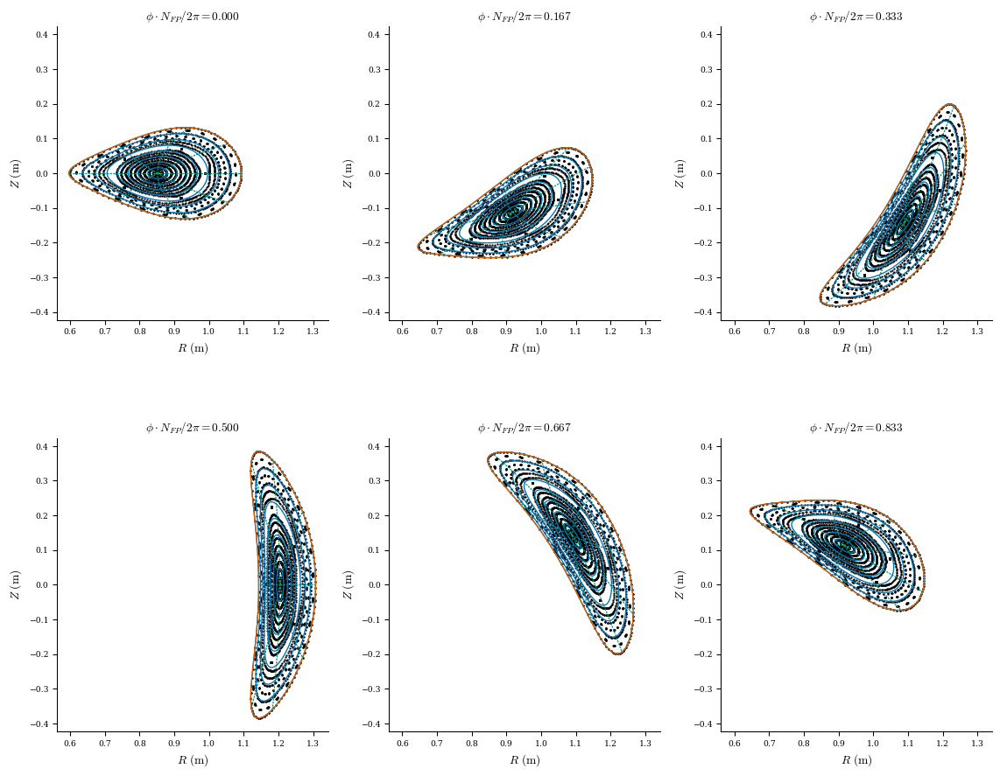

In [39]:
fig, ax = plot_field_lines(optimized_coilset2, eq_poin, nrho=18, ntransit=200)
plt.show()
# fig.savefig("landreman2021-islands-after-poincare.png", dpi=1000)

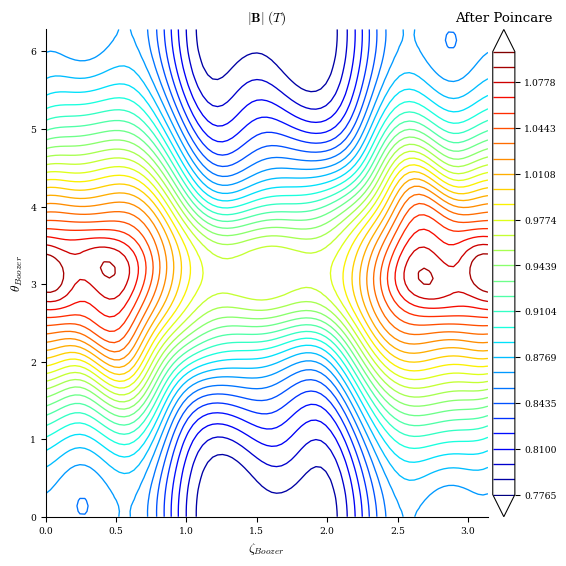

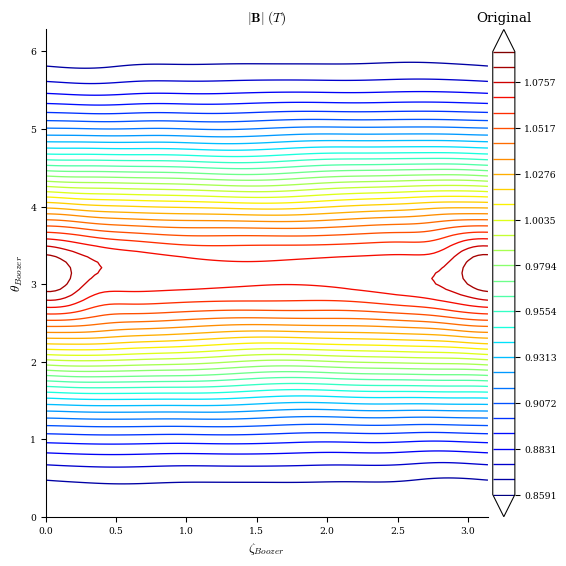

In [41]:
plot_boozer_surface(eq_poin)
plt.title("After Poincare")
plot_boozer_surface(eq)
plt.title("Original");

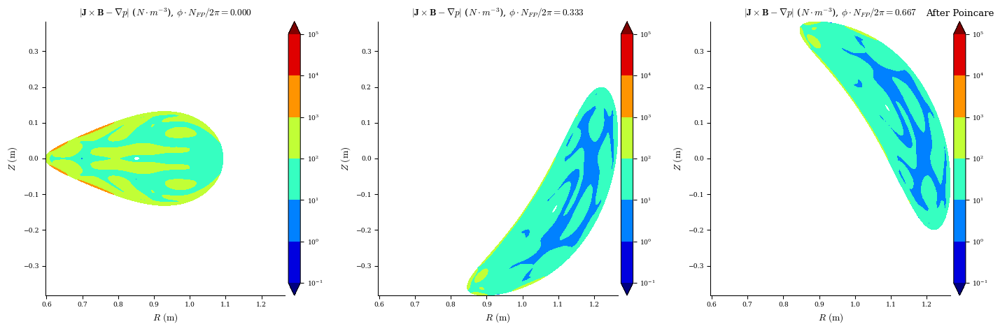

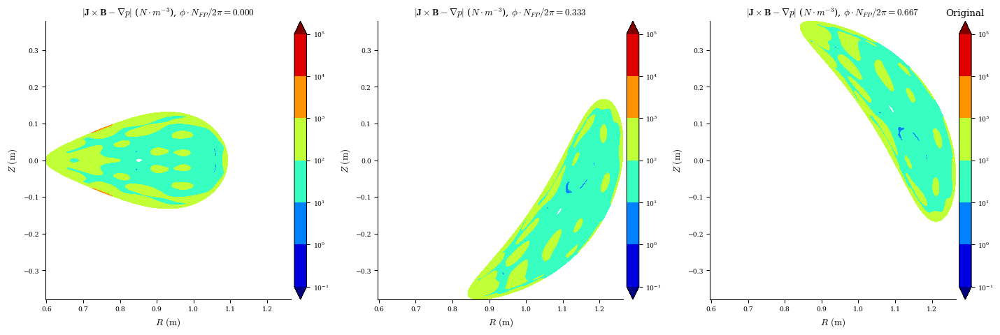

In [42]:
levels = np.logspace(-1,5, 7)
plot_section(eq_poin, "|F|", phi=3, log=True, levels=levels);
plt.title("After Poincare")
plot_section(eq, "|F|", phi=3, log=True, levels=levels);
plt.title("Original");

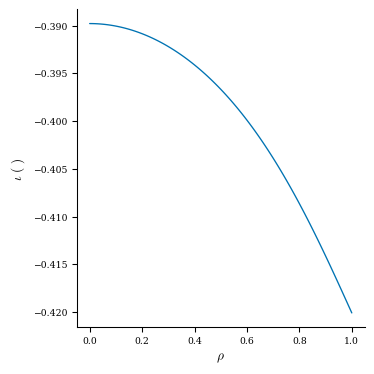

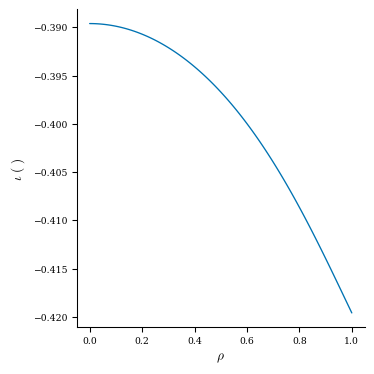

In [43]:
plot_1d(eq, "iota")
plot_1d(eq_poin, "iota");

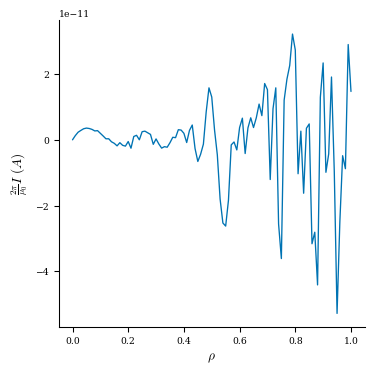

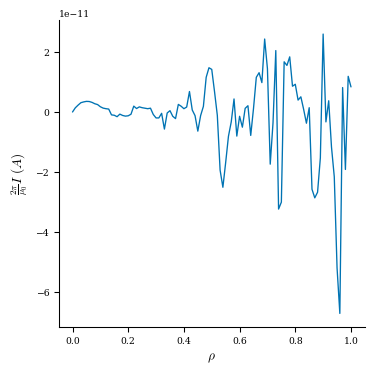

In [44]:
plot_1d(eq, "current")
plot_1d(eq_poin, "current");

# Don't fix $\lambda$

In [27]:
eq._xsection = eq.get_surface_at(zeta=0)
eq_poin_noL = eq.copy()
solve_poincare(eq_poin_noL, maxiter=350, ftol=5e-4, fix_lambda=False)
eq_poin_noL.surface = eq_poin_noL.get_surface_at(rho=1)

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 65.7 ms
Timer: Objective build = 207 ms
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed Psi
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed sheet current
Building objective: lambda gauge
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Building objective: self_consistency section R
Building objective: self_consistency section Z
Building objective: self_consistency section λ
Timer: Objective build = 195 ms
Timer: LinearConstraintProjection build = 2.91 sec
Number of parameters: 1100
Number of objectives: 5346
Timer: Initializing the optimization = 3.55 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          1.729e-09                           

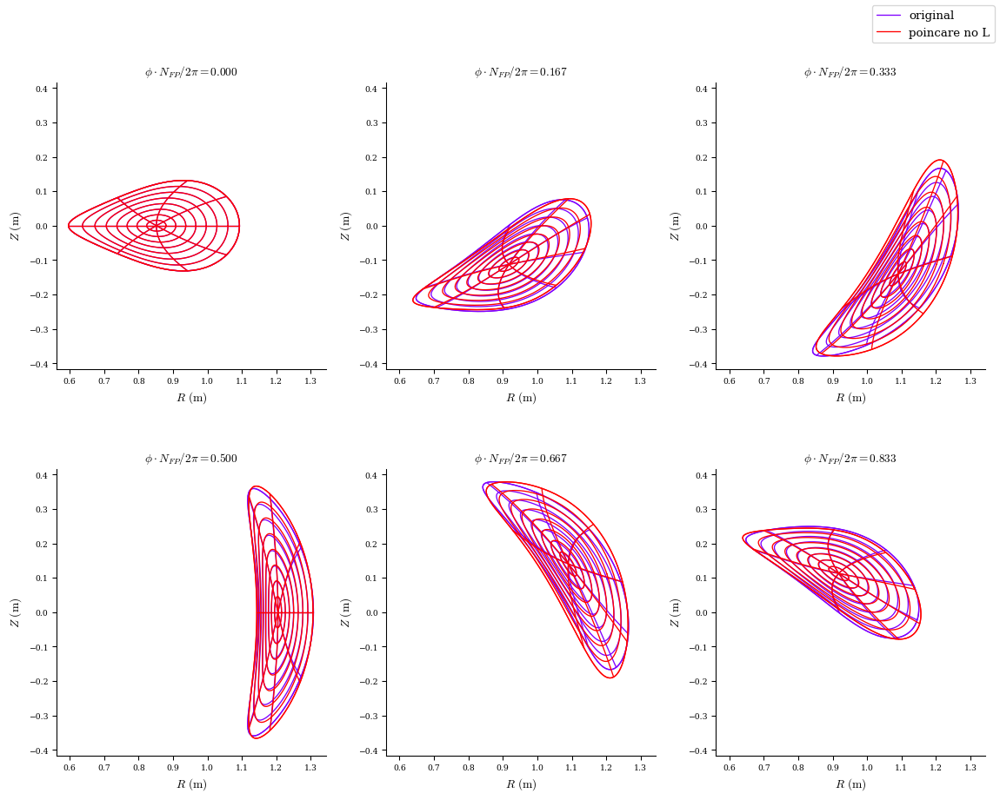

In [28]:
plot_comparison([eq, eq_poin_noL], labels=["original", "poincare no L"]);

In [29]:
# create the constant offset surface
surf3 = eq_poin_noL.surface.constant_offset_surface(
    offset=0.25,  # desired offset
    M=16,  # Poloidal resolution of desired offset surface
    N=16,  # Toroidal resolution of desired offset surface
    grid=LinearGrid(M=32, N=32, NFP=eq_poin_noL.NFP),
)  # grid of points on base surface to evaluate unit normal and find points on offset surface,
# generally should be twice the desired resolution
optimized_coilset3 = optimize_coils_regcoil(surf3, eq_poin_noL)

##########################################################
Calculating Phi_SV for lambda_regularization = 0.00000e+00
##########################################################
chi^2 B = 1.92989e-10
min Bnormal = 5.55341e-19 (T)
Max Bnormal = 1.44527e-07 (T)
Avg Bnormal = 1.85248e-08 (T)
min Bnormal = 5.91338e-19 (unitless)
Max Bnormal = 1.53895e-07 (unitless)
Avg Bnormal = 1.97256e-08 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 1.00000e-30
##########################################################
chi^2 B = 1.92989e-10
min Bnormal = 5.25420e-19 (T)
Max Bnormal = 1.44527e-07 (T)
Avg Bnormal = 1.85248e-08 (T)
min Bnormal = 5.59477e-19 (unitless)
Max Bnormal = 1.53895e-07 (unitless)
Avg Bnormal = 1.97256e-08 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 4.28133e-29
##########################################################
chi^2 B = 1.92989e-10
m

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {0, 1, 2, 3, 4, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 59, 60, 61, 62, 63}.



In [30]:
eq_poin_noL.surface = eq_poin_noL.get_surface_at(rho=1.0)
fig = plot_3d(
    eq_poin_noL.surface,
    "B*n",
    field=optimized_coilset3,
    field_grid=coil_grid,
    grid=plot_grid,
)

fig = plot_coils(optimized_coilset3, fig=fig)
fig.show()

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {0, 1, 2, 3, 4, 27, 28, 29, 30, 31}.

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {0, 1, 2, 3, 4, 27, 28, 29, 30, 31}.

/CODES/DESC/desc/utils.py:563: UserWarning:

Found coils which are nearly intersecting according to the given grid it is recommended to check coils closely or run function again with a higher resolution grid. Offending coil indices are {0, 1, 2, 3, 4, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 59, 60, 61, 62, 63}.



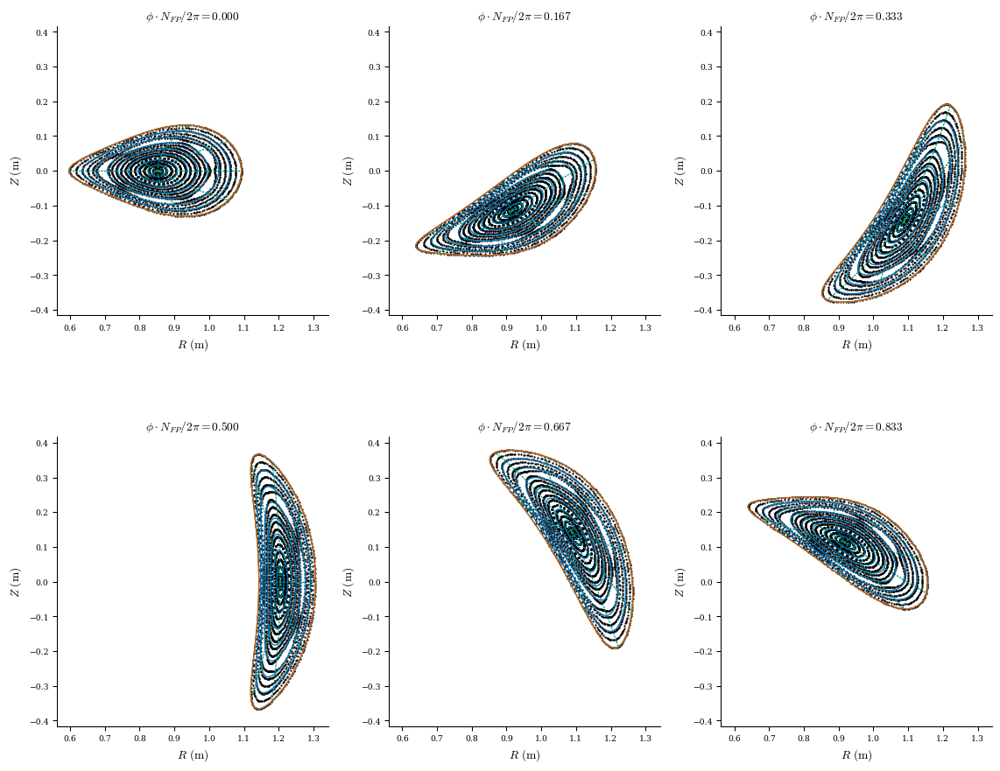

In [31]:
fig, ax = plot_field_lines(optimized_coilset3, eq_poin_noL, nrho=18, ntransit=200)
plt.show()
# fig.savefig("landreman2021-islands-after-poincare.png", dpi=1000)

(<Figure size 384.108x384.108 with 1 Axes>,
 <Axes: xlabel='$\\rho$', ylabel='$ \\iota ~(~)$'>)

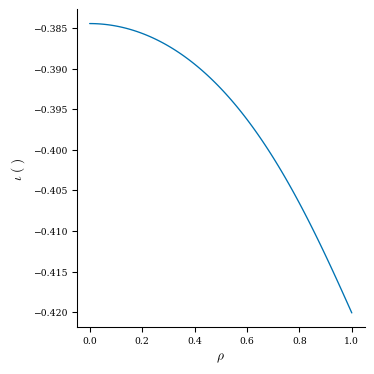

In [32]:
plot_1d(eq_poin_noL, "iota")

# Fix n=0 modes

In [46]:
eq_poin0 = eq.copy()
R_modes = eq_poin0.R_basis.modes[eq_poin0.R_basis.modes[:, 2] == 0]
Z_modes = eq_poin0.Z_basis.modes[eq_poin0.Z_basis.modes[:, 2] == 0]
cons = (
    FixModeR(eq_poin0, modes=R_modes),
    FixModeZ(eq_poin0, modes=Z_modes),
    FixPressure(eq_poin0),
    FixPsi(eq_poin0),
    FixCurrent(eq_poin0),
    FixSheetCurrent(eq_poin0),
    FixLambdaGauge(eq_poin0),
)
cons = maybe_add_self_consistency(eq_poin0, cons)
obj = ObjectiveFunction(ForceBalance(eq_poin0))
eq_poin0.solve(
    constraints=cons,
    objective=obj,
    maxiter=500,
    ftol=5e-4,
    verbose=3,
)

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 61.0 ms
Timer: Objective build = 82.1 ms
Building objective: fix mode R
Building objective: fix mode Z
Building objective: fixed pressure
Building objective: fixed Psi
Building objective: fixed current
Building objective: fixed sheet current
Building objective: lambda gauge
Building objective: self_consistency lcfs R
Building objective: self_consistency lcfs Z
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Timer: Objective build = 245 ms
Timer: LinearConstraintProjection build = 5.96 sec
Number of parameters: 1100
Number of objectives: 5346
Timer: Initializing the optimization = 6.39 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          1.729e-09                                    2.307e-07   
       1              7          1.261e-09      4.68

(Equilibrium at 0x7f0ceded0b90 (L=8, M=8, N=8, NFP=2, sym=True, spectral_indexing=ansi, vacuum=True, profile='current'),
     message: Optimization terminated successfully.
              `ftol` condition satisfied. (ftol=5.00e-04)
     success: True
         fun: [ 6.026e-09 -7.091e-08 ... -3.746e-07 -4.653e-07]
           x: [-9.686e-05 -9.818e-06 ...  1.076e-04 -1.831e-05]
         nit: 479
        cost: 1.7145929920360496e-10
           v: [ 1.000e+00  1.000e+00 ...  1.000e+00  1.000e+00]
  optimality: 9.537052183192763e-08
        nfev: 596
        njev: 480
        allx: [Array([ 2.016e-07, -1.531e-07, ..., -3.769e-20,  6.776e-20],      dtype=float64), Array([-1.453e-08,  2.192e-07, ...,  3.692e-07, -2.772e-07],      dtype=float64), Array([ 1.244e-08,  3.029e-07, ...,  3.256e-07, -4.723e-07],      dtype=float64), Array([ 1.339e-07,  3.839e-07, ...,  1.638e-07, -8.097e-07],      dtype=float64), Array([ 2.036e-07,  4.133e-07, ...,  9.386e-08, -9.815e-07],      dtype=float64), Array(

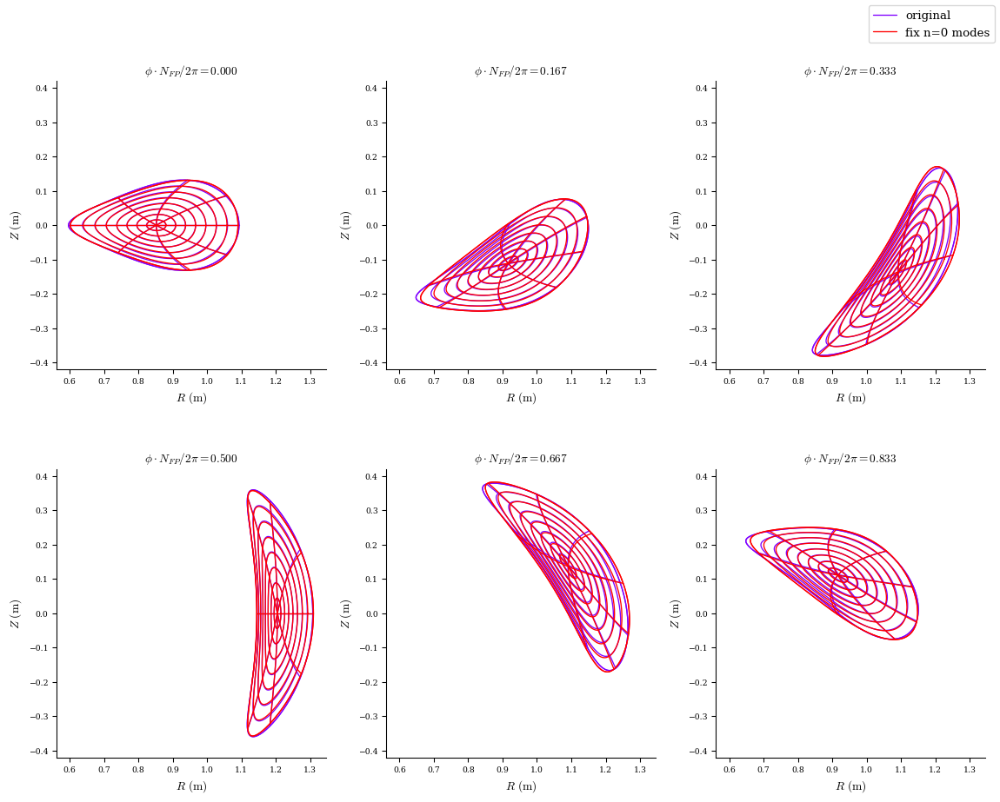

In [47]:
plot_comparison([eq, eq_poin0], labels=["original", "fix n=0 modes"]);

In [48]:
# create the constant offset surface
surf4 = eq_poin0.surface.constant_offset_surface(
    offset=0.25,  # desired offset
    M=16,  # Poloidal resolution of desired offset surface
    N=16,  # Toroidal resolution of desired offset surface
    grid=LinearGrid(M=32, N=32, NFP=eq_poin0.NFP),
)  # grid of points on base surface to evaluate unit normal and find points on offset surface,
# generally should be twice the desired resolution
optimized_coilset4 = optimize_coils_regcoil(surf3, eq_poin0)

##########################################################
Calculating Phi_SV for lambda_regularization = 0.00000e+00
##########################################################
chi^2 B = 4.38757e-11
min Bnormal = 9.12710e-19 (T)
Max Bnormal = 4.97278e-08 (T)
Avg Bnormal = 9.37185e-09 (T)
min Bnormal = 9.46519e-19 (unitless)
Max Bnormal = 5.15698e-08 (unitless)
Avg Bnormal = 9.71900e-09 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 1.00000e-30
##########################################################
chi^2 B = 4.38757e-11
min Bnormal = 9.12710e-19 (T)
Max Bnormal = 4.97278e-08 (T)
Avg Bnormal = 9.37185e-09 (T)
min Bnormal = 9.46519e-19 (unitless)
Max Bnormal = 5.15698e-08 (unitless)
Avg Bnormal = 9.71900e-09 (unitless)
##########################################################
Calculating Phi_SV for lambda_regularization = 4.28133e-29
##########################################################
chi^2 B = 4.38757e-11
m

In [49]:
eq_poin0.surface = eq_poin0.get_surface_at(rho=1.0)
fig = plot_3d(
    eq_poin0.surface,
    "B*n",
    field=optimized_coilset4,
    field_grid=coil_grid,
    grid=plot_grid,
)

fig = plot_coils(optimized_coilset4, fig=fig)
fig.show()

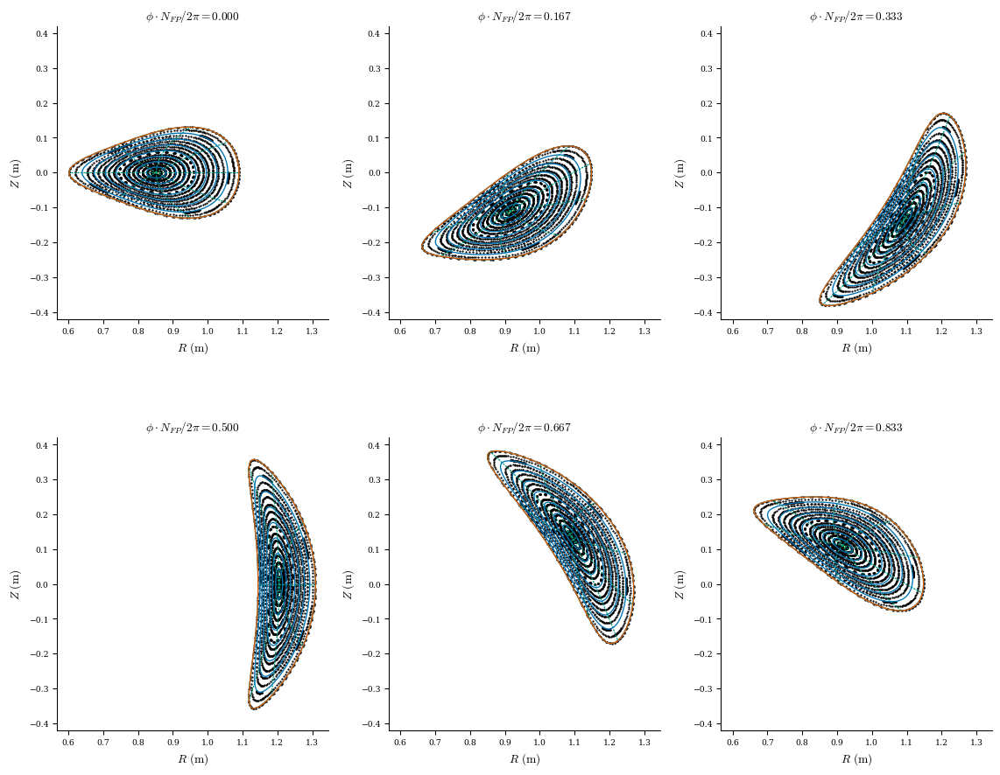

In [50]:
fig, ax = plot_field_lines(optimized_coilset4, eq_poin0, nrho=18, ntransit=200)
plt.show()
fig.savefig("landreman2021-islands-after-pfixed-n0-modes.png", dpi=1000)

(<Figure size 384.108x384.108 with 1 Axes>,
 <Axes: xlabel='$\\rho$', ylabel='$ \\iota ~(~)$'>)

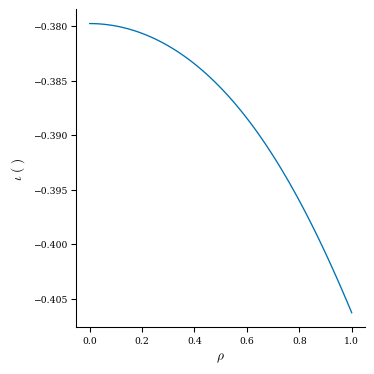

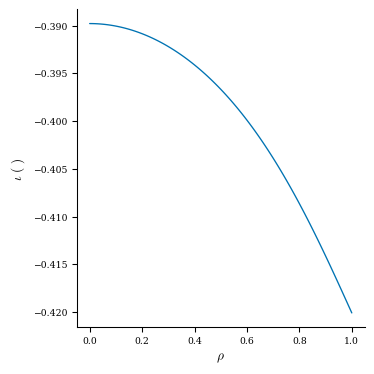

In [53]:
plot_1d(eq_poin0, "iota")
plot_1d(eq, "iota")

Text(0.5, 1.0, 'Original')

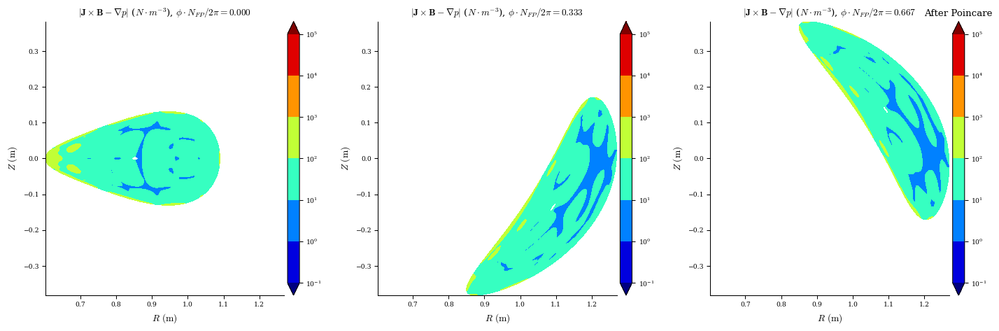

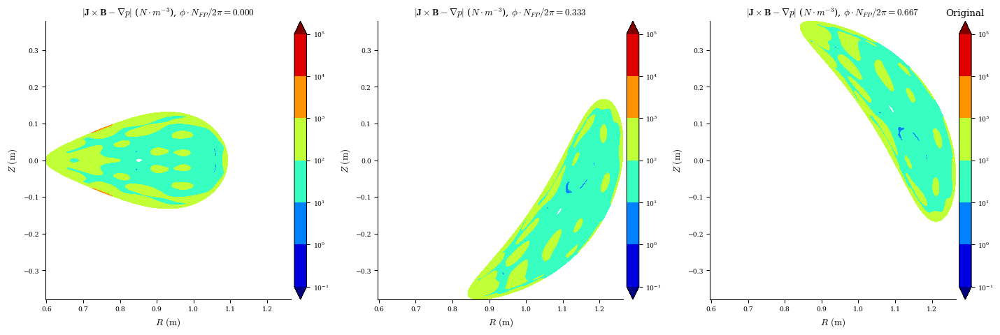

In [52]:
levels = np.logspace(-1, 5, 7)
plot_section(eq_poin0, "|F|", phi=3, log=True, levels=levels)
plt.title("After Poincare")
plot_section(eq, "|F|", phi=3, log=True, levels=levels)
plt.title("Original")